# CMPINF 2100 Project Proposal 
## Sarah Scott 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import seaborn as sns

### PART A: MOTIVATION

I selected the **Tidy Tuesday Spotify Songs** project, as I believe the goals of this project most closely aligns with data I might experience in my own field. The primary goal for this project is to predict a song's popularity based on the features associated with a song. It is not difficult to identify similarities within the world of publishing, e.g., tracking a book's popularity based on features associated with a book. As someone new to working with data in this way, I also felt the various inputs/variables might be easier to understand and work with. 

After working with the data, I'm not sure if I will continue this project versus another (I was also interested in the Pitt Athletics project, as working with customers can be very similar to working with patrons). On initial review I am a *little* confused and unable to identify variables that **strongly** influence the output variable. I can see some really interesting observations between *inputs*, but I'm still looking for strong relationships between inputs and outputs. Hopefully, with more time (both to examine the data and to solidify concepts learned from the lectures) I may be able to better see trends. 

### PART B: PREDICTIVE MODELING DISCUSSION

This project is a **regression problem**, as I am attempting to predict a continuous variable - in this case, the popularity of a song. 

The inputs include: 
* `playlist_genre`
* `playlist_subgenre`
* `danceability`
* `energy`
* `key` 
* `loudness`
* `mode`
* `speechiness`
* `acousticness`
* `instrumentalness`
* `liveness`
* `valence`
* `tempo`
* `duration_ms` 

The output, or variable I am trying to predict is `track_popularity`.  

The columns that are identifiers, and thus not used in the models, include: 
* `track_id`
* `track_name`
* `track_artist`
* `track_album_id`
* `track_album_name`
* `track_album_release_date`
* `playlist_name`
* `playlist_id` 

*Note: I debated whether `track_album_release_date` could also be used as a factor for song popularity, but opted **not** to include it, focusing instead on the qualities of the song itself*

As I mentioned in **Part A**, after my initial deep dive into the data, I am not totally sure what inputs influence a song's popularity. I went into this assignment with some assumptions regarding the influence of certain inputs (e.g., `playlist_genre` and `danceability`), but these did not display as clearly as I expected. Some inputs did not offer much impact (e.g., `mode` and `key`); others clearly have an impact, but I'm not fully confident in my ability to address what it is quite yet (e.g., `speechiness`). 

### PART C: EXPLORATORY DATA ANALYSIS

#### 1. Essential Exploration Activities

In [2]:
df = pd.read_csv('spotify.csv')

In [3]:
df.shape

(32833, 23)

In [4]:
df.columns

Index(['track_id', 'track_name', 'track_artist', 'track_popularity',
       'track_album_id', 'track_album_name', 'track_album_release_date',
       'playlist_name', 'playlist_id', 'playlist_genre', 'playlist_subgenre',
       'danceability', 'energy', 'key', 'loudness', 'mode', 'speechiness',
       'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo',
       'duration_ms'],
      dtype='object')

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32833 entries, 0 to 32832
Data columns (total 23 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   track_id                  32833 non-null  object 
 1   track_name                32828 non-null  object 
 2   track_artist              32828 non-null  object 
 3   track_popularity          32833 non-null  int64  
 4   track_album_id            32833 non-null  object 
 5   track_album_name          32828 non-null  object 
 6   track_album_release_date  32833 non-null  object 
 7   playlist_name             32833 non-null  object 
 8   playlist_id               32833 non-null  object 
 9   playlist_genre            32833 non-null  object 
 10  playlist_subgenre         32833 non-null  object 
 11  danceability              32833 non-null  float64
 12  energy                    32833 non-null  float64
 13  key                       32833 non-null  int64  
 14  loudne

In [6]:
df.nunique()

track_id                    28356
track_name                  23449
track_artist                10692
track_popularity              101
track_album_id              22545
track_album_name            19743
track_album_release_date     4530
playlist_name                 449
playlist_id                   471
playlist_genre                  6
playlist_subgenre              24
danceability                  822
energy                        952
key                            12
loudness                    10222
mode                            2
speechiness                  1270
acousticness                 3731
instrumentalness             4729
liveness                     1624
valence                      1362
tempo                       17684
duration_ms                 19785
dtype: int64

In [7]:
df.isna().sum()

track_id                    0
track_name                  5
track_artist                5
track_popularity            0
track_album_id              0
track_album_name            5
track_album_release_date    0
playlist_name               0
playlist_id                 0
playlist_genre              0
playlist_subgenre           0
danceability                0
energy                      0
key                         0
loudness                    0
mode                        0
speechiness                 0
acousticness                0
instrumentalness            0
liveness                    0
valence                     0
tempo                       0
duration_ms                 0
dtype: int64

**Note:** The columns `key` and `mode` will be treated as non-numeric columns. 

I will also turn `playlist_subgenre` and `playlist_genre` into categorial variables. 

In [8]:
df[['key','mode','playlist_subgenre','playlist_genre']] = df[['key','mode','playlist_subgenre','playlist_genre']].astype('category')

In [9]:
df.dtypes

track_id                      object
track_name                    object
track_artist                  object
track_popularity               int64
track_album_id                object
track_album_name              object
track_album_release_date      object
playlist_name                 object
playlist_id                   object
playlist_genre              category
playlist_subgenre           category
danceability                 float64
energy                       float64
key                         category
loudness                     float64
mode                        category
speechiness                  float64
acousticness                 float64
instrumentalness             float64
liveness                     float64
valence                      float64
tempo                        float64
duration_ms                    int64
dtype: object

#### 2. Marginal Distributions for Continuous Variables 

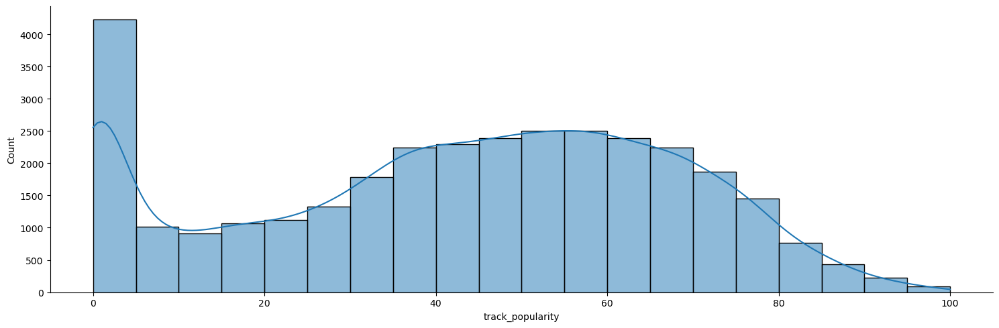

In [10]:
sns.displot(data=df, x='track_popularity', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Danceability**

Describes how suitable a track is for dancing. A value of 0.0 is least danceable and 1.0 is most danceable.

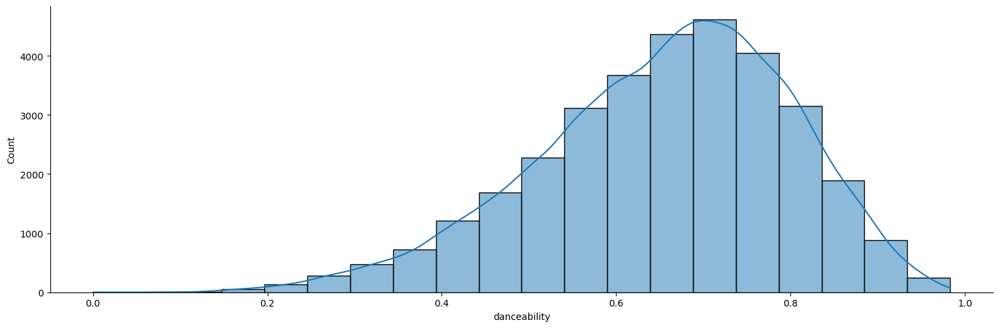

In [11]:
sns.displot(data=df, x='danceability', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Energy**

Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity (energetic tracks feel fast, loud, and noisy).

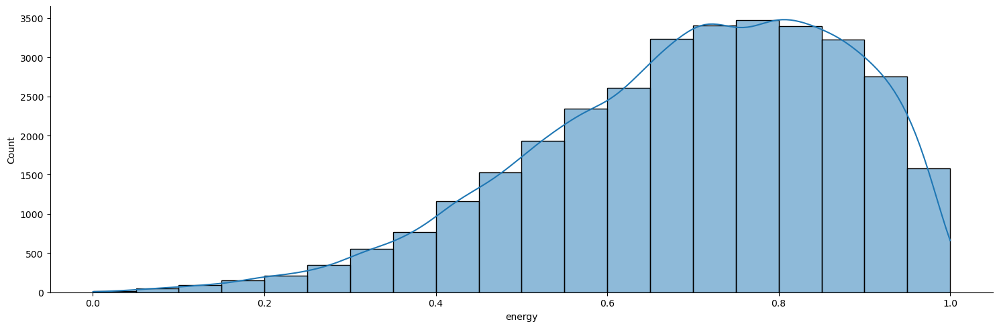

In [12]:
sns.displot(data=df, x='energy', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Loudness**

The overall loudness of a track in decibels (dB). Values range between -60 and 0 db.

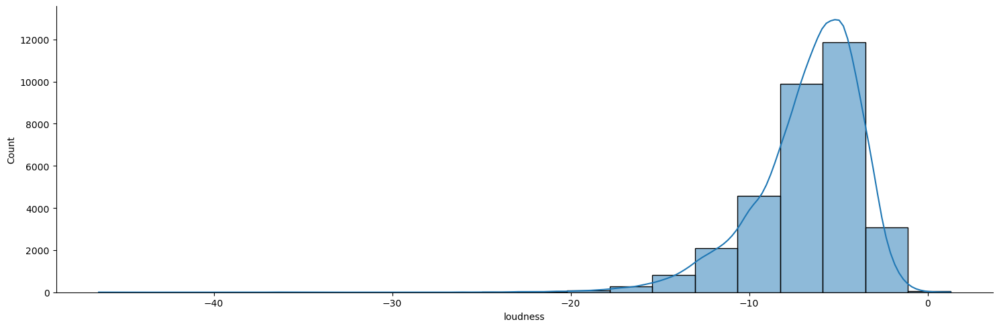

In [13]:
sns.displot(data=df, x='loudness', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Speechiness**

Speechiness detects the presence of spoken words in a track. Values above 0.66 describe tracks that are probably made entirely of spoken words; values between 0.33 and 0.66 describe tracks that may contain both music and speech; values below 0.33 most likely represent music and other non-speech-like tracks.

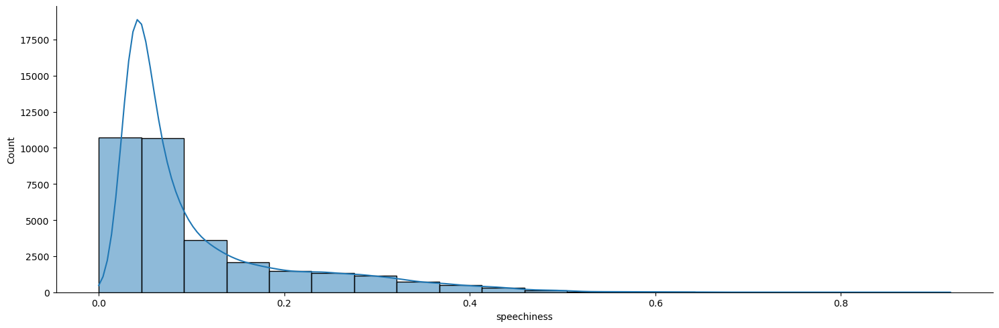

In [14]:
sns.displot(data=df, x='speechiness', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Acousticness**

A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic.

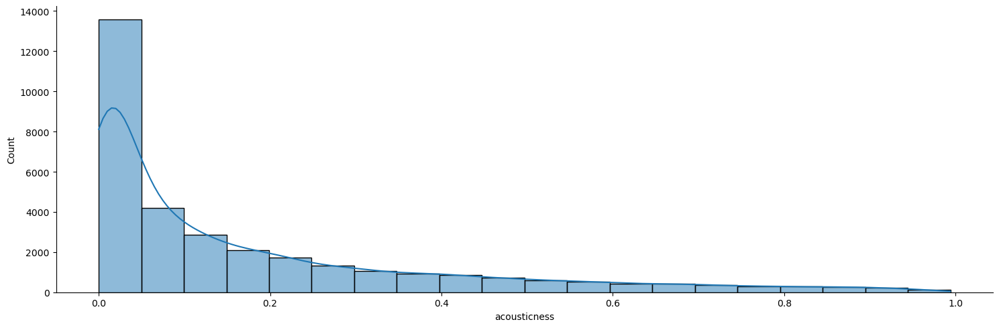

In [15]:
sns.displot(data=df, x='acousticness', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Instrumentalness**

Predicts whether a track contains no vocals. The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content.

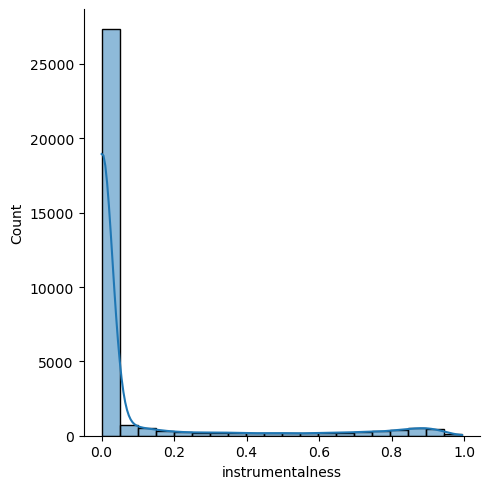

In [16]:
sns.displot(data=df, x='instrumentalness', kind='hist', bins=20, kde=True)
plt.show()

**Definition: Liveness**

Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live.

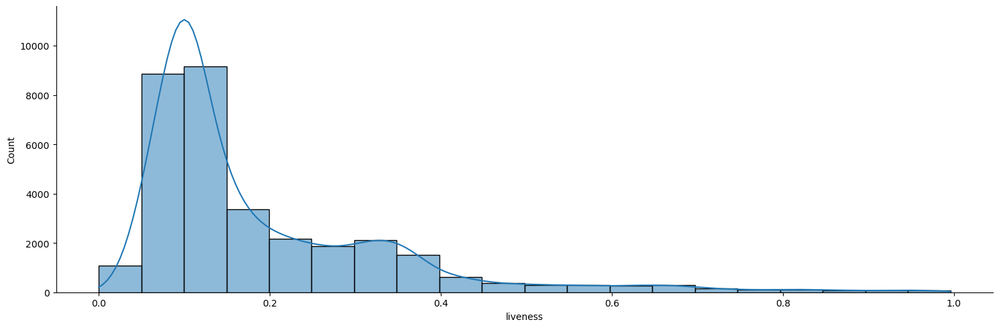

In [17]:
sns.displot(data=df, x='liveness', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Valence**

A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive, while tracks with low valence sound more negative. 

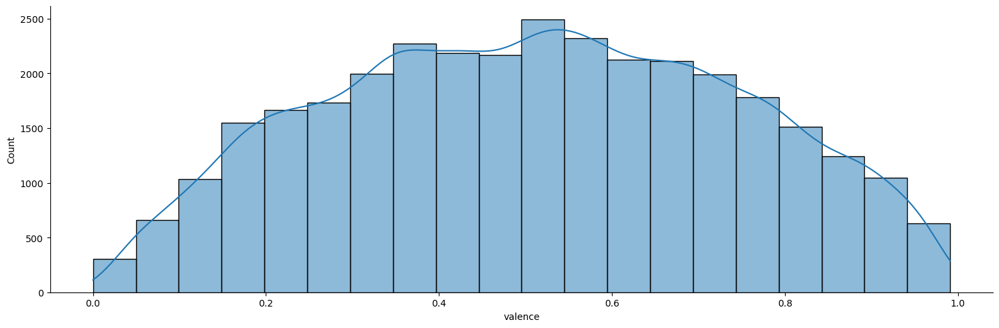

In [18]:
sns.displot(data=df, x='valence', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Tempo**

The overall estimated tempo (speed/pace) of a track in beats per minute (BPM). 

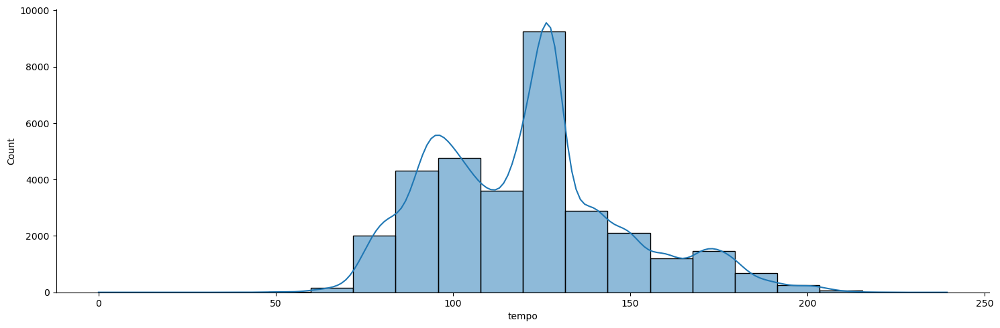

In [19]:
sns.displot(data=df, x='tempo', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

**Definition: Duration**

The duration of the song in milliseconds. 

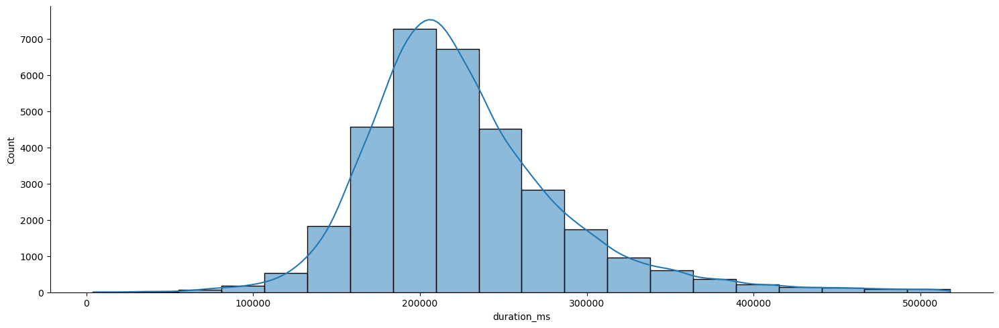

In [20]:
sns.displot(data=df, x='duration_ms', kind='hist', bins=20, kde=True, aspect=3)
plt.show()

#### 3. Marginal Distributions for Categorical Variables

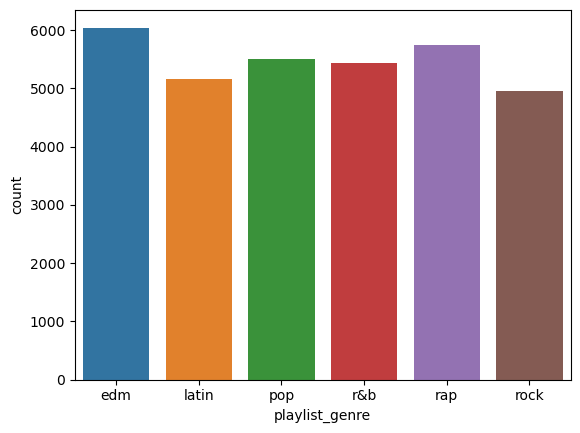

In [21]:
sns.countplot(data=df, x='playlist_genre')
plt.show()

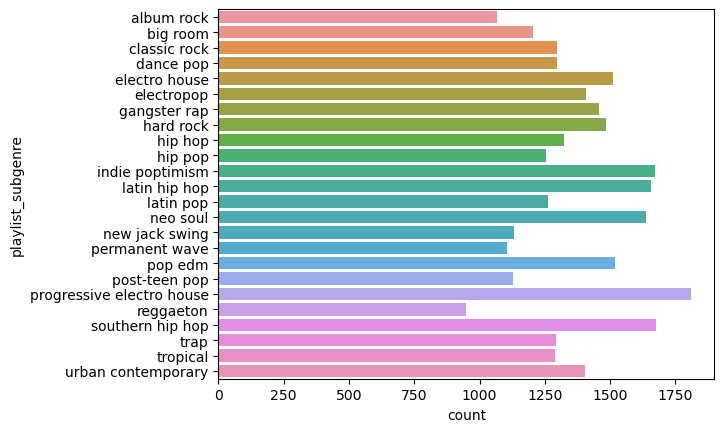

In [22]:
fig, ax = plt.subplots()
sns.countplot( data=df, y='playlist_subgenre', ax=ax )
plt.show()

**Definition: Key**

The estimated overall key of the track. If no key was detected, the value is -1.

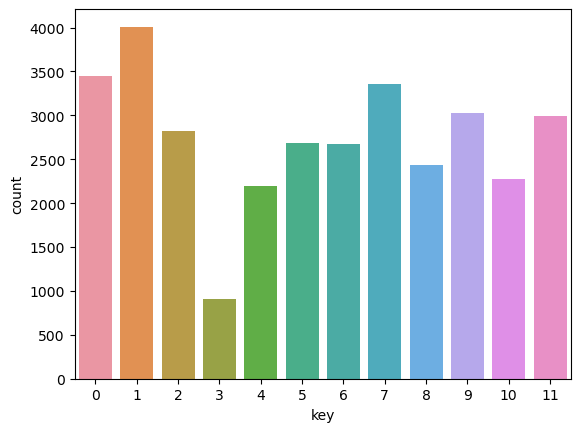

In [23]:
sns.countplot(data=df, x='key')
plt.show()

**Definition: Mode**

Mode indicates the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0.

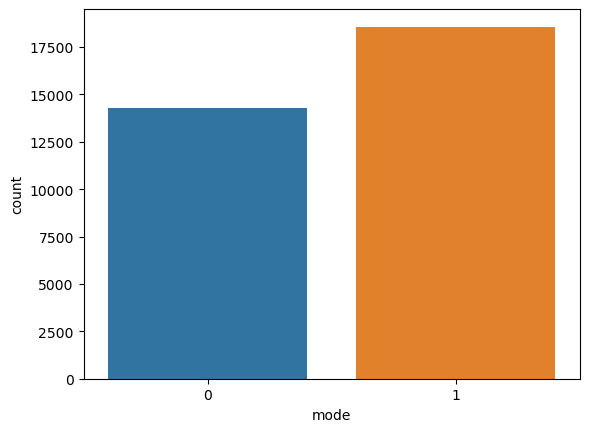

In [24]:
sns.countplot(data=df, x='mode')
plt.show()

#### 4. Relationship Distributions

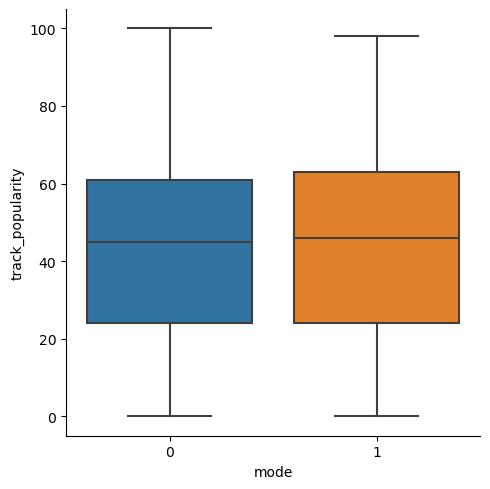

In [25]:
sns.catplot(data=df, x='mode', y='track_popularity', kind='box')
plt.show()

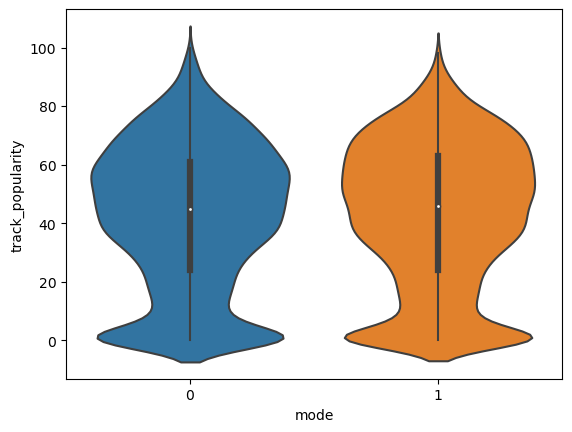

In [26]:
sns.violinplot(data=df, x='mode', y='track_popularity')
plt.show()

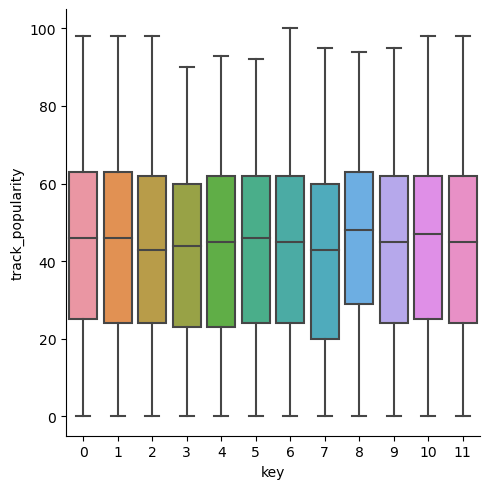

In [27]:
sns.catplot(data=df, x='key', y='track_popularity', kind='box')
plt.show()

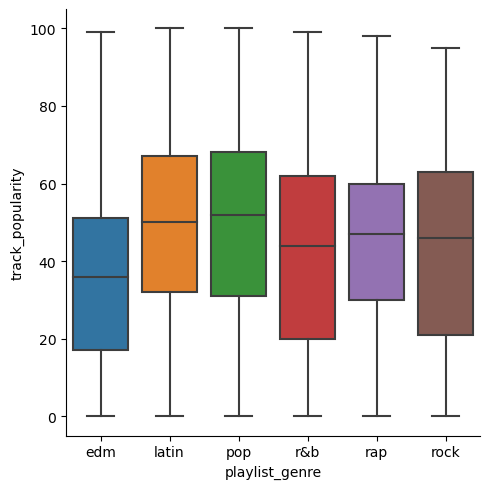

In [28]:
sns.catplot( data = df, x='playlist_genre', y='track_popularity', kind='box')
plt.show()

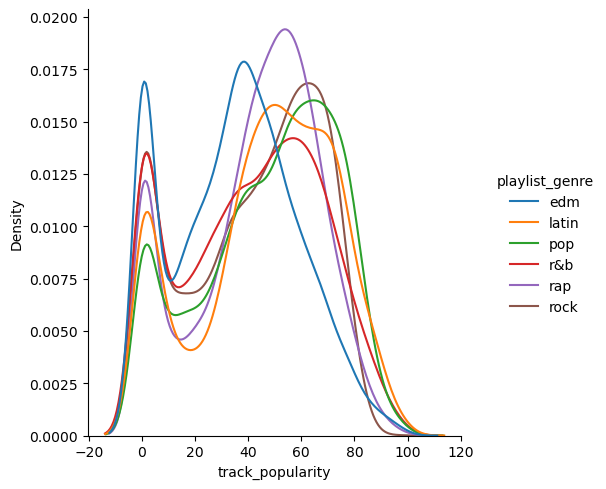

In [29]:
sns.displot(data = df, x='track_popularity', kind='kde', hue='playlist_genre', common_norm=False)

plt.show()

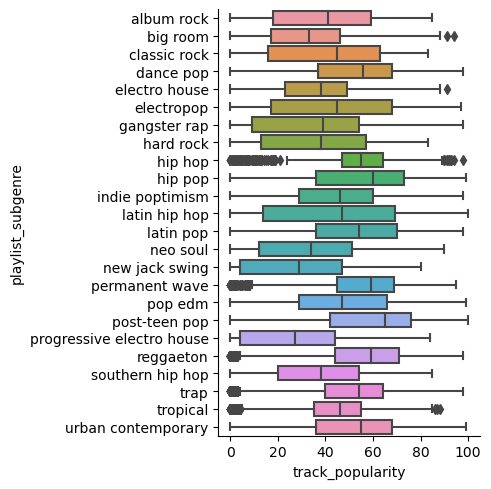

In [30]:
sns.catplot( data = df, x='track_popularity', y='playlist_subgenre', kind='box')
plt.show()

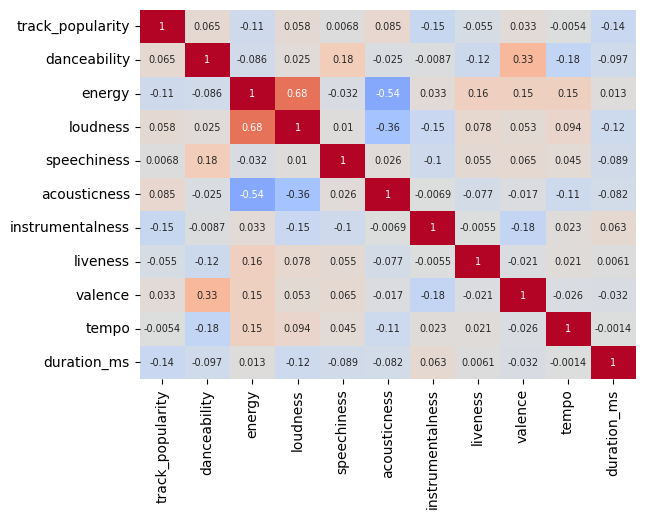

In [31]:
fig, ax = plt.subplots()

sns.heatmap(data = df.corr(numeric_only=True),
            vmin=-1, vmax=1, center=0,
            cmap='coolwarm', cbar=False,
            annot=True, annot_kws={'size': 7},
            ax=ax)

plt.show()

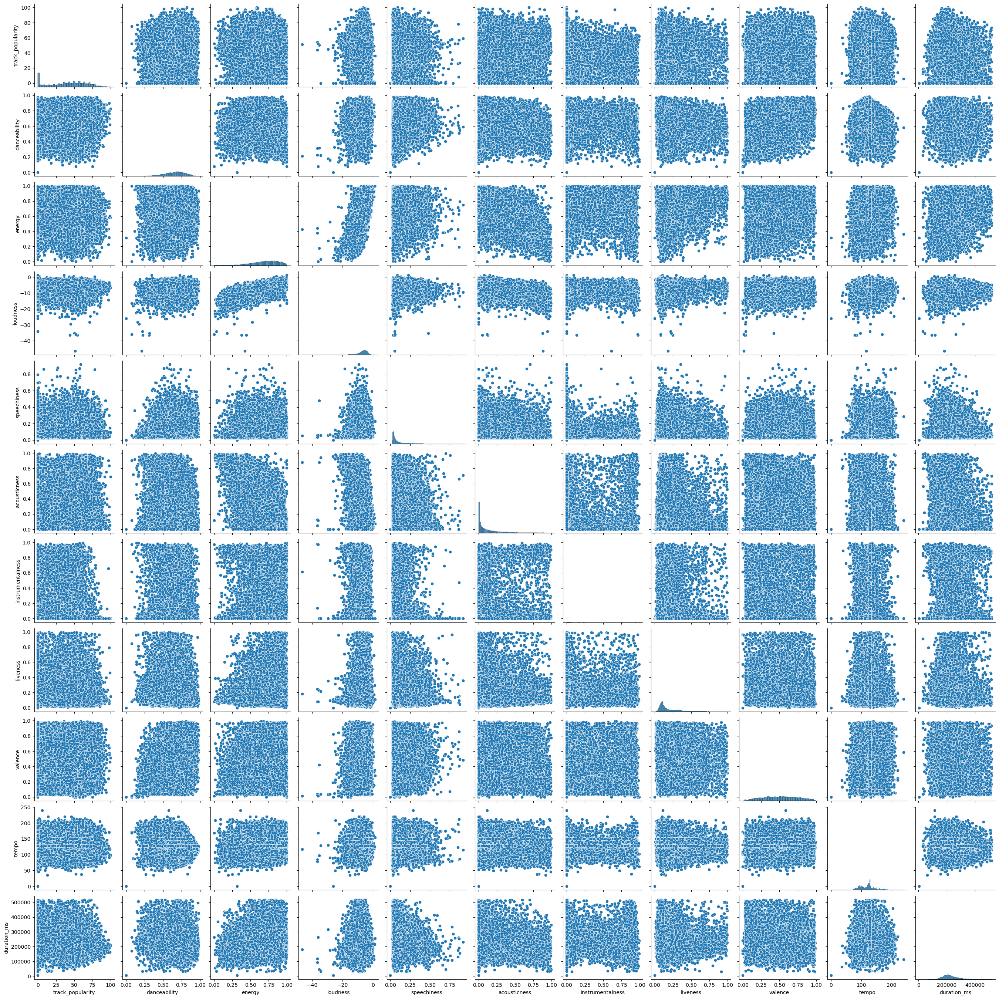

In [32]:
sns.pairplot(data = df, diag_kws={'common_norm': False})

plt.show()

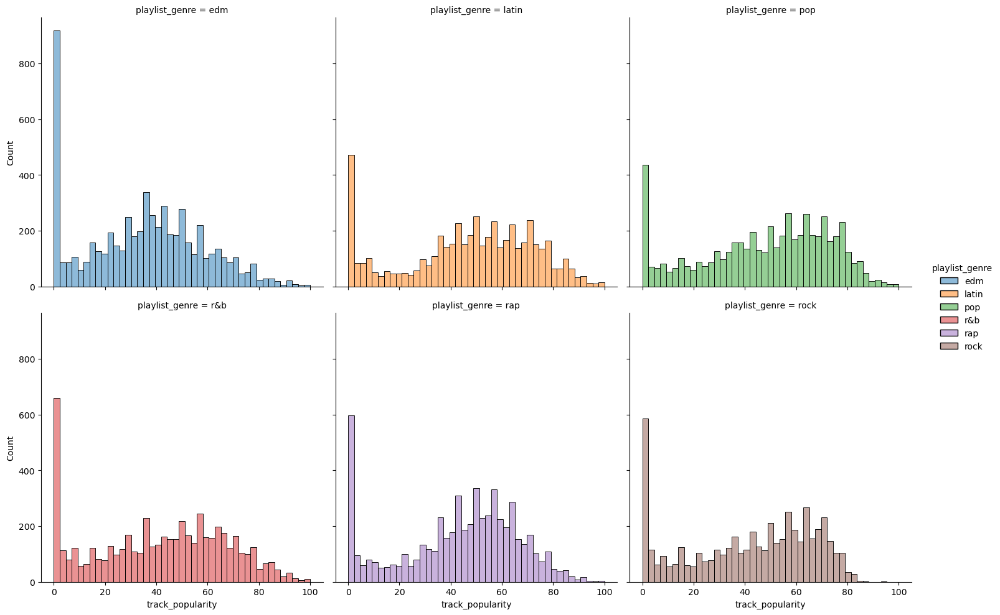

In [33]:
sns.displot(data = df, x='track_popularity', col='playlist_genre',  hue='playlist_genre', col_wrap=3)

plt.show()

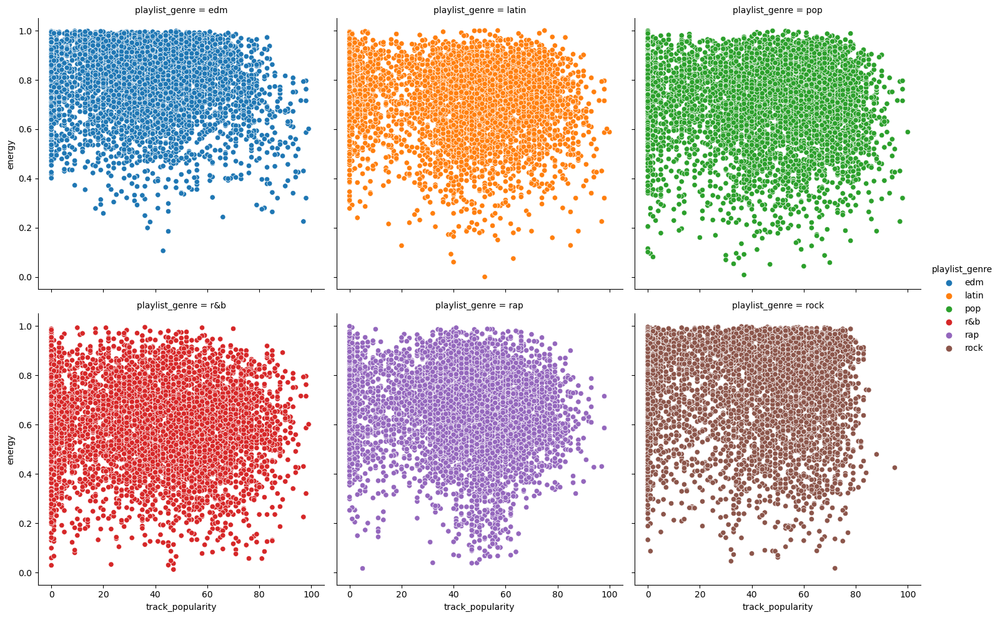

In [39]:
sns.relplot(data = df, x='track_popularity', y='energy', hue='playlist_genre', col='playlist_genre', col_wrap=3)

plt.show()

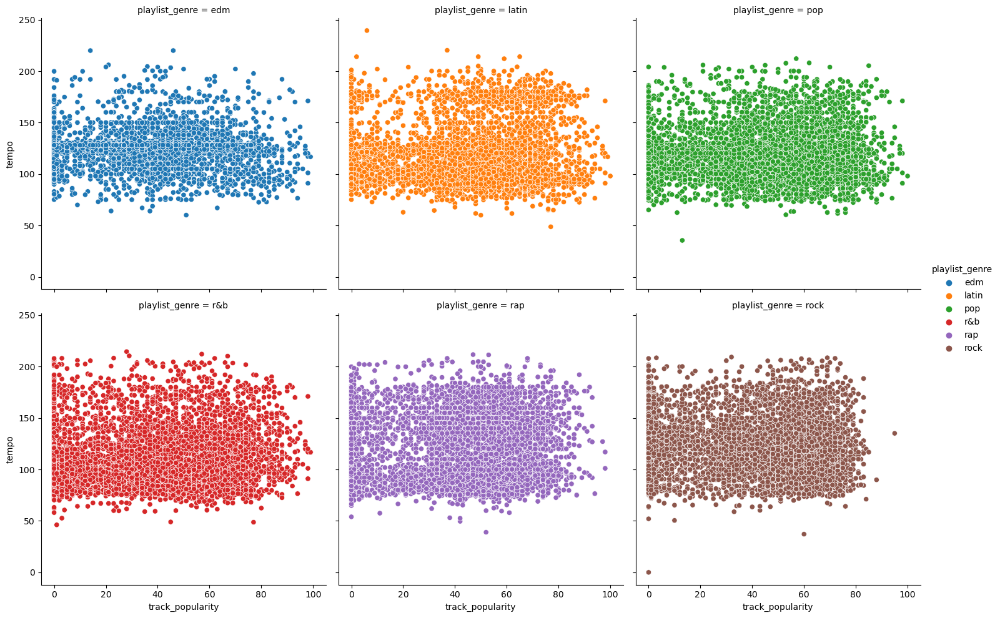

In [37]:
sns.relplot(data = df, x='track_popularity', y='tempo', hue='playlist_genre', col='playlist_genre', col_wrap=3)

plt.show()

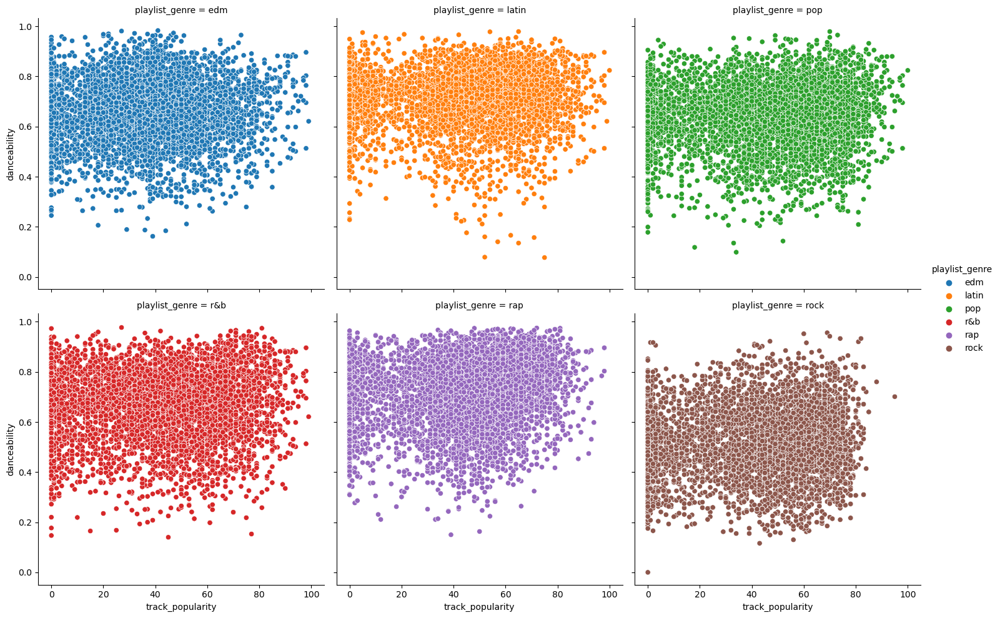

In [36]:
sns.relplot(data = df, x='track_popularity', y='danceability', hue='playlist_genre', col='playlist_genre', col_wrap=3)

plt.show()

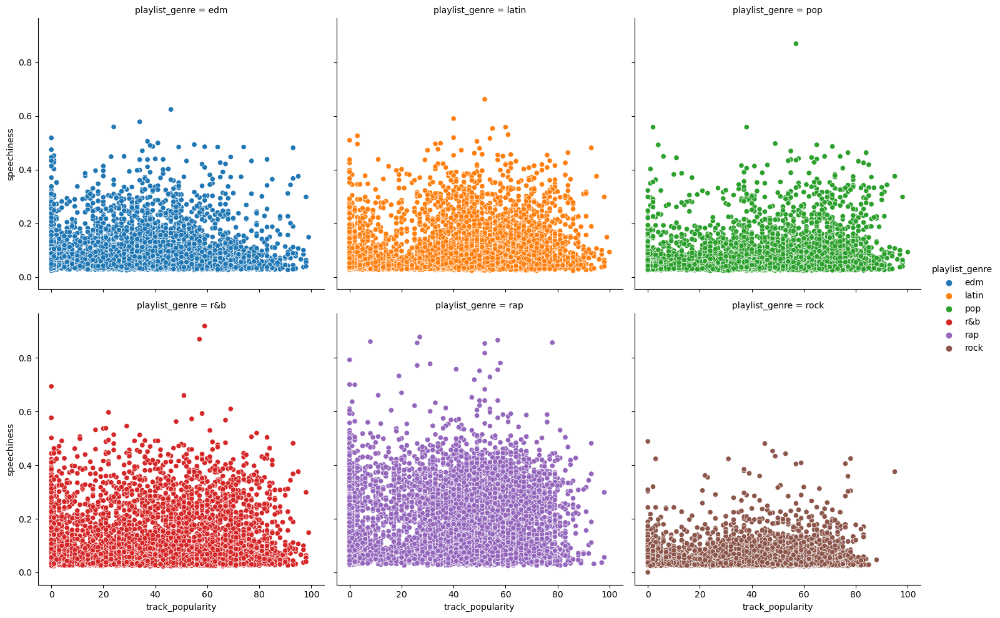

In [38]:
sns.relplot(data = df, x='track_popularity', y='speechiness', hue='playlist_genre', col='playlist_genre', col_wrap=3)

plt.show()

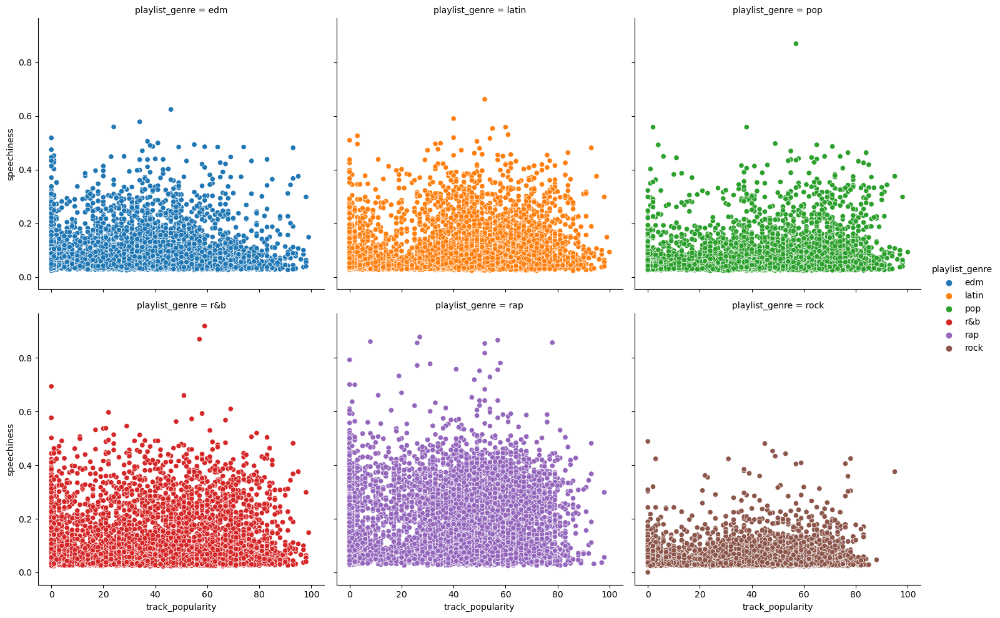

In [52]:
sns.relplot(data = df, x='track_popularity', y='speechiness', hue='playlist_genre', col='playlist_genre', col_wrap=3)

plt.show()

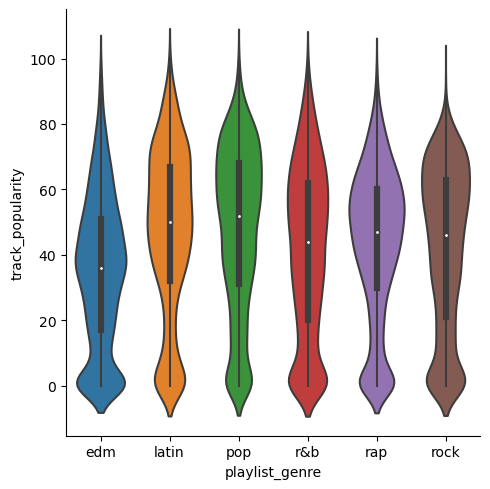

In [40]:
sns.catplot(data=df, x='playlist_genre', y='track_popularity', kind='violin')
plt.show()

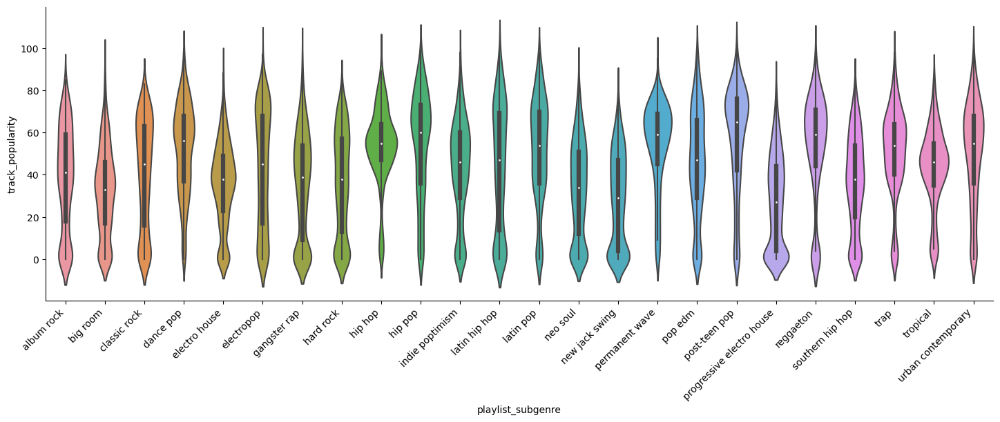

In [41]:
sns.catplot(data=df, x='playlist_subgenre', y='track_popularity', kind='violin', aspect=3)
plt.xticks(rotation=45, ha='right')
plt.show()

### PART D: CLUSTER ANALYSIS

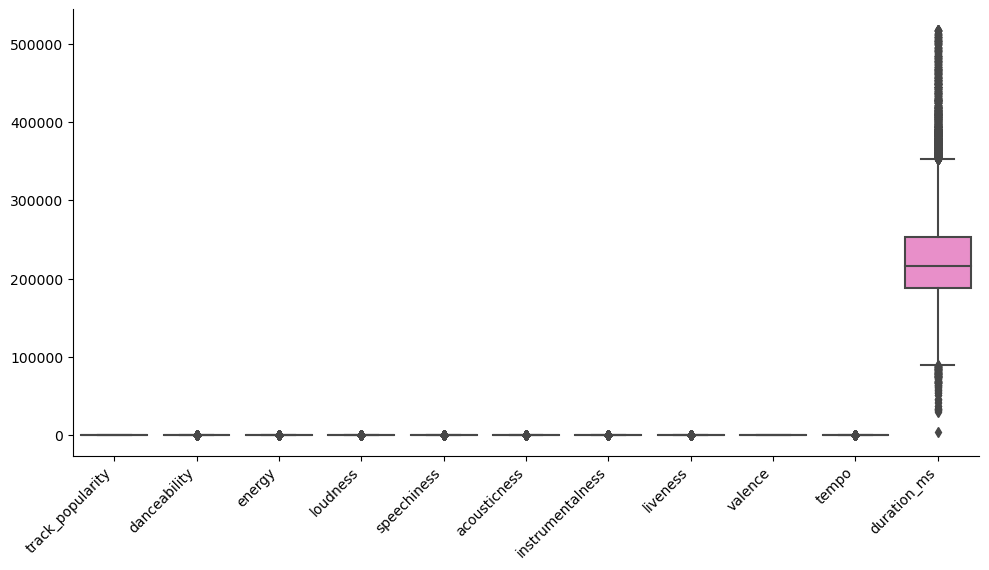

In [42]:
sns.catplot(data = df, kind='box', aspect=2)
plt.xticks(rotation=45, ha='right')
plt.show()

In [43]:
df.shape

(32833, 23)

In [44]:
df_clean = df.dropna().copy()

In [45]:
df_clean.shape

(32828, 23)

Dropping any row with missing values, I only lost 5 rows of data. 

In [46]:
df_clean = df_clean.drop(columns=['track_popularity'])

In [47]:
df_clean.columns

Index(['track_id', 'track_name', 'track_artist', 'track_album_id',
       'track_album_name', 'track_album_release_date', 'playlist_name',
       'playlist_id', 'playlist_genre', 'playlist_subgenre', 'danceability',
       'energy', 'key', 'loudness', 'mode', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'duration_ms'],
      dtype='object')

In [48]:
df_features = df_clean.select_dtypes('number').copy()

In [49]:
from sklearn.preprocessing import StandardScaler

In [50]:
Xdf = StandardScaler().fit_transform( df_features )

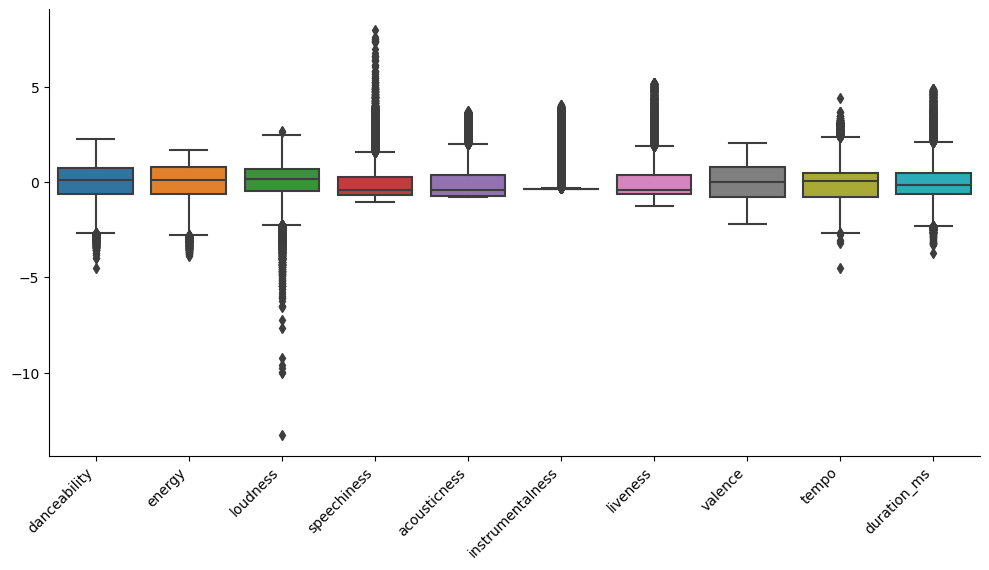

In [51]:
sns.catplot(data = pd.DataFrame(Xdf, columns=df_features.columns), kind='box', aspect=2)
plt.xticks(rotation=45, ha='right')

plt.show()

In [52]:
from sklearn.cluster import KMeans

In [53]:
clusters_2 = KMeans(n_clusters=2, random_state=121, n_init=25, max_iter=500).fit_predict( Xdf )

In [54]:
df_clean_copy = df_clean.copy()

In [55]:
df_clean_copy['k2'] = pd.Series( clusters_2, index=df_clean_copy.index ).astype('category')

In [56]:
df_clean_copy.k2.value_counts()


0    23205
1     9623
Name: k2, dtype: int64

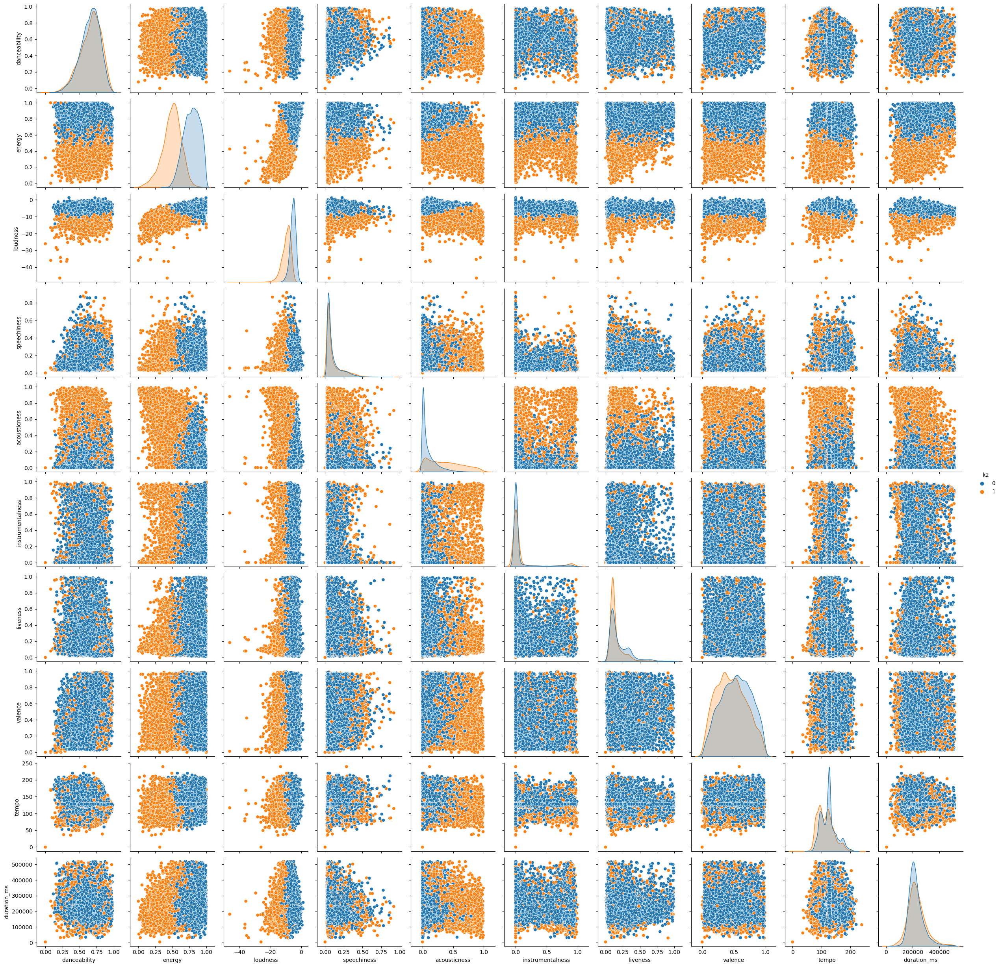

In [57]:
sns.pairplot(data = df_clean_copy, hue='k2', diag_kws={'common_norm': False})
plt.show()

In [58]:
from sklearn.decomposition import PCA

In [59]:
pca_df = PCA(n_components=2).fit_transform( Xdf )

In [60]:
pca_df_df = pd.DataFrame( pca_df, columns=['pc01', 'pc02'] )

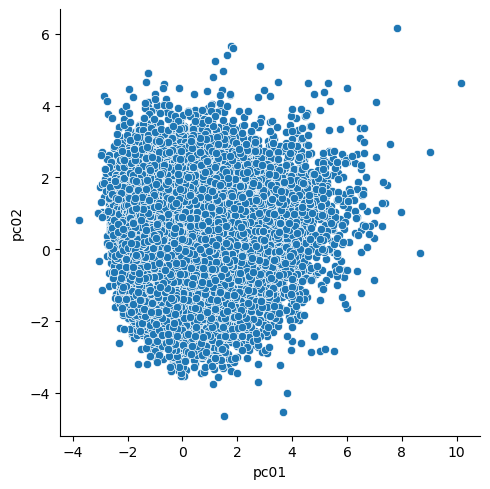

In [61]:
sns.relplot(data = pca_df_df, x='pc01', y='pc02')

plt.show()

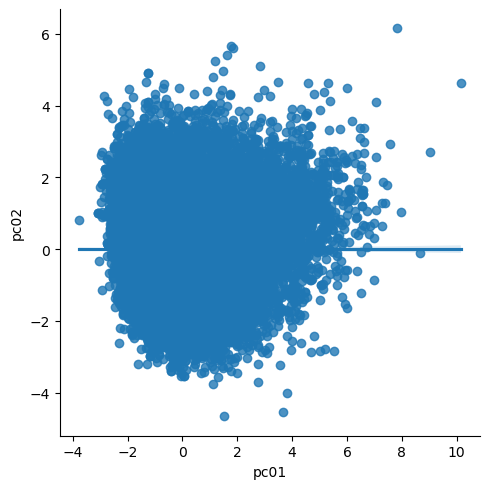

In [62]:
sns.lmplot(data = pca_df_df, x='pc01', y='pc02')

plt.show()

In [63]:
tots_within = []

K = range(1, 31)

for k in K:
    km = KMeans(n_clusters=k, random_state=121, n_init=25, max_iter=500)
    km = km.fit( Xdf )
    
    tots_within.append( km.inertia_ )

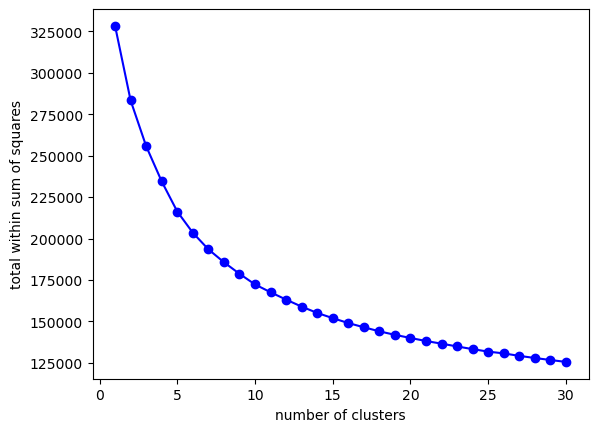

In [74]:
fig, ax = plt.subplots()

ax.plot( K, tots_within, 'bo-' )
ax.set_xlabel('number of clusters')
ax.set_ylabel('total within sum of squares')

plt.show()

In [75]:
clusters_6 = KMeans(n_clusters=6, random_state=121, n_init=25, max_iter=500).fit_predict( Xdf )

In [76]:
df_clean_copy['k6'] = pd.Series( clusters_6, index=df_clean_copy.index ).astype('category')

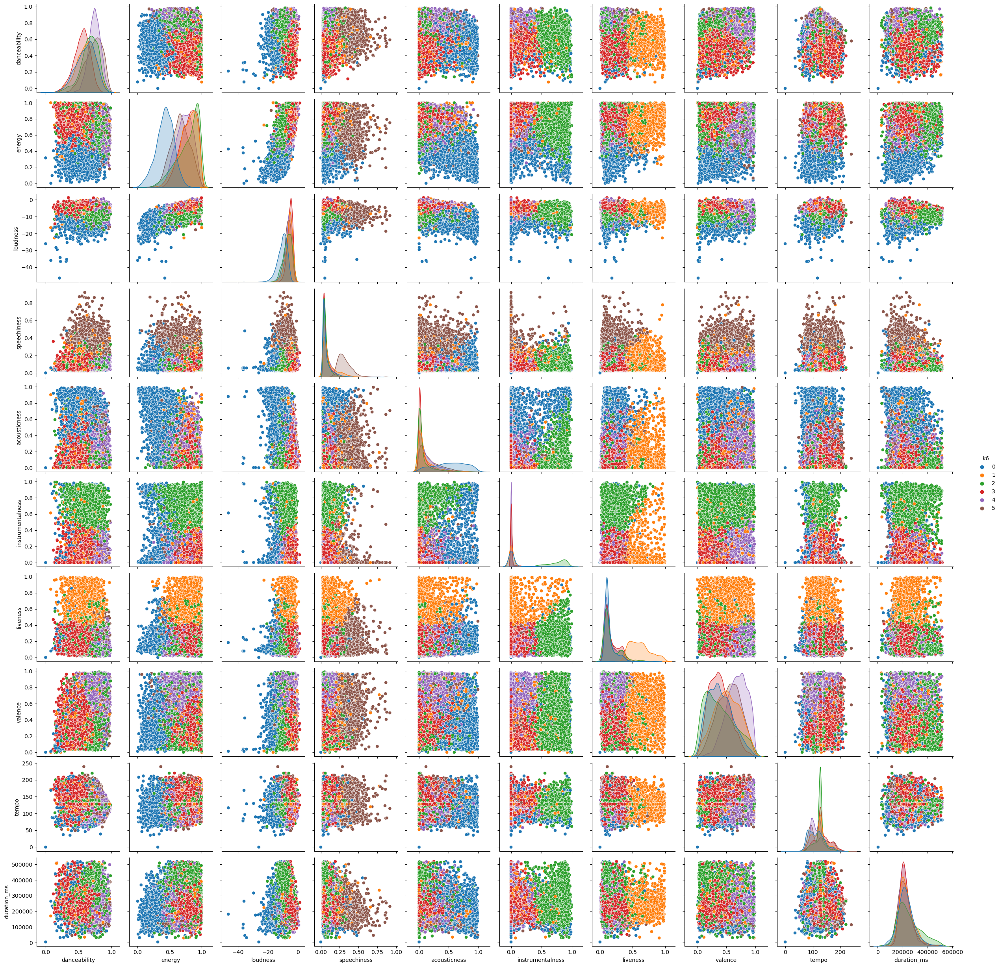

In [77]:
sns.pairplot(data = df_clean_copy, hue='k6', diag_kws={'common_norm': False})
plt.show()